<a href="https://colab.research.google.com/github/Jordine/convnets-with-gradcam-for-deadly-diseases-diagnosis/blob/main/Diagnosis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Hướng dẫn sử dụng**

**Default**

1. Chọn connect ở góc phải trên màn hình (dưới comment)
2. Chọn 'run all' ở nút runtime bên trên
3. Xem chẩn đoán trong prediction.csv và folder gradcam (trong 'Files' ở thanh bên trái)

**Custom**

1. Chạy tab đầu tiên bằng nút tam giác bên cạnh
3. Vào 'files' ở thanh bên trái (cuối cùng từ trên xuống)
4. Vào 'samples' và chọn một folder chứa ảnh để chẩn đoán. (người dùng có thể tự upload folder của mình vào 'files')
3. Copy path của folder đó
6. Ctrl+V vào directory ở tab thứ 2
7. Chọn mô hình thích hợp ở tab thứ 3
8. Lựa chọn gradcam ở tab thứ 4 tùy theo ý muốn
9. Chọn Run all
10. Xem chẩn đoán trong prediction.csv và folder gradcam (trong 'Files' ở thanh bên trái)


In [ ]:
#@title Tải các thư viện và tập tin cần thiết

import os
import keras
import tensorflow as tf
import pandas as pd
from IPython.display import clear_output
!pip install tf-explain
from tf_explain.core.grad_cam import GradCAM
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, Input, BatchNormalization
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

!git clone https://github.com/Jordine/convnets-with-gradcam-for-deadly-diseases-diagnosis.git

!unzip '/content/convnets-with-gradcam-for-deadly-diseases-diagnosis/samples.zip'
clear_output()

In [ ]:
#@title Folder chứa hình ảnh đế chẩn đoán
#@markdown Chọn đường dẫn tới folder



directory = '/content/samples/cancer' #@param {type:"string"}
name_directory = directory + '/'
image_directory = directory + '/*'
image_directory = tf.io.gfile.glob(image_directory)


if os.path.exists(directory + '/.ipynb_checkpoints'):
  os.rmdir(directory + '/.ipynb_checkpoints')



In [ ]:
#@title Chuẩn bị mô hình
#@markdown Chọn mô hình thích hợp

model = 'Ung th\u01B0' #@param ["Ung thư", "Alzheimers", "Covid và viêm phổi"]


#setup class names and model names
model_dict = {
    "Ung thư": "cancer",
    "Alzheimers": "alz",
    "Covid và viêm phổi": "covpneu"
}

class_dict = {
    "Ung thư": ['Lành tính', 'Ác tính'],
    "Alzheimers": ['Alzheimers', 'Nhận thức bình thường', 'Suy giảm nhận thức nhẹ'],
    "Covid và viêm phổi": ['Covid', 'Bình thường', 'Viêm phổi']
}

name = model_dict[model]
class_names = class_dict[model]


#import model weights
model_dir = '/content/convnets-with-gradcam-for-deadly-diseases-diagnosis/'
num_classes = len(class_names)



tf.keras.backend.clear_session()

model = Sequential()

model.add(Input(shape=(224,224,3)))


model.add(Conv2D(16,(3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(32,(3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64,(3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128,(3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(Conv2D(256,(3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(Conv2D(512,(3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(Flatten())

model.add(Dense(512,activation='relu'))
model.add(BatchNormalization())


model.add(Dense(256,activation='relu'))
model.add(BatchNormalization())


model.add(Dense(128,activation='relu'))
model.add(BatchNormalization())


model.add(Dense(64,activation='relu'))
model.add(BatchNormalization())


model.add(Dense(num_classes,activation='softmax'))


model.load_weights(model_dir+name+'.h5')


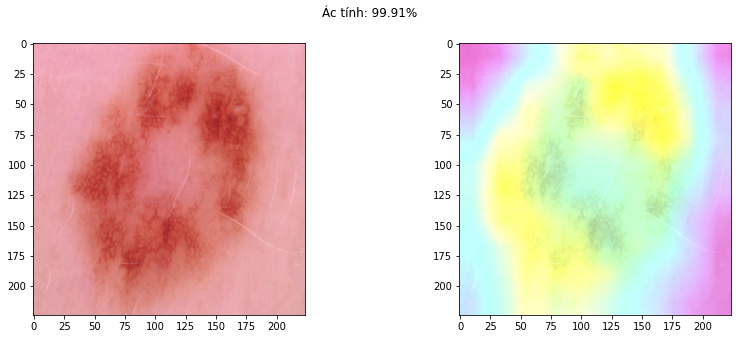

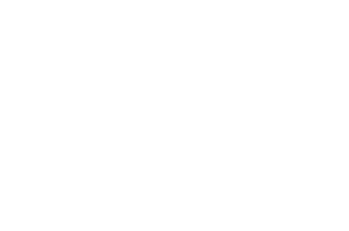

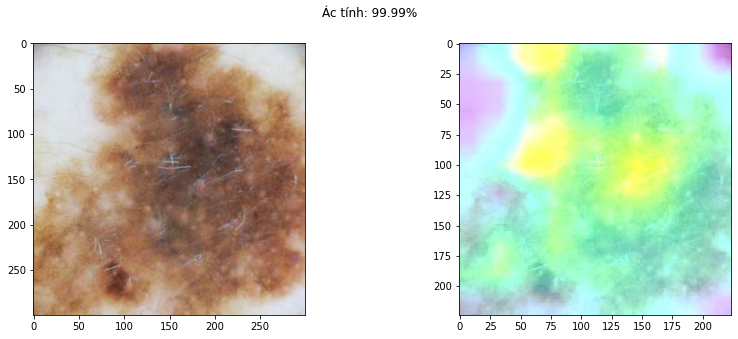

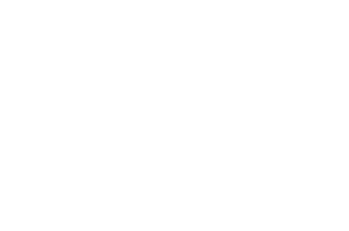

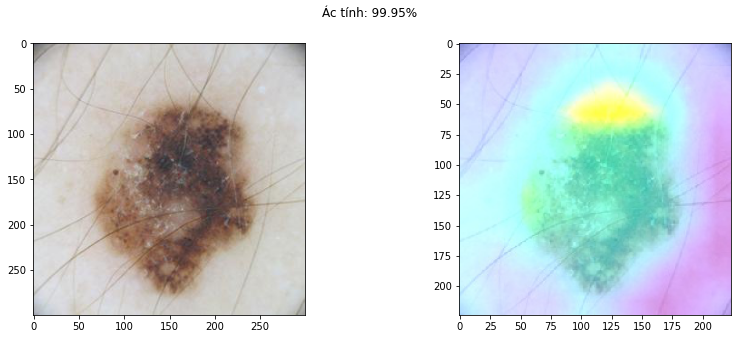

...

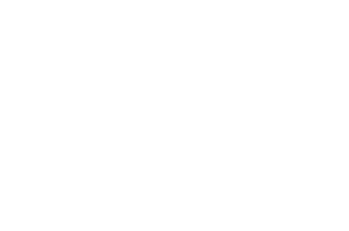

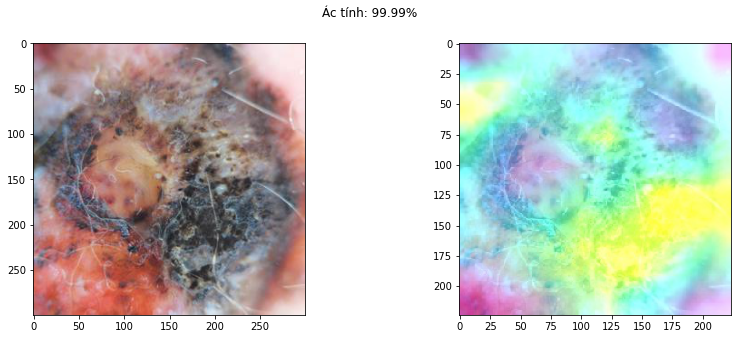

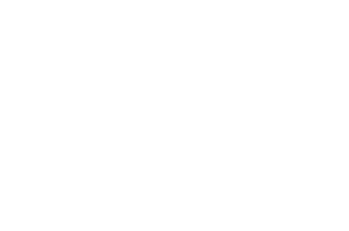

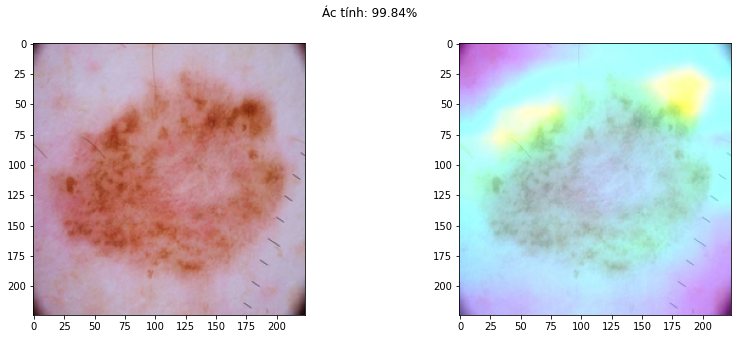

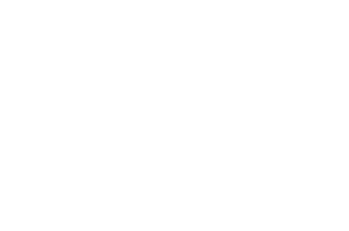

In [ ]:
from tensorflow.python.lib.io.file_io import file_exists
#@title Chẩn đoán

#@markdown Đánh dấu để sử dụng và lưu ảnh GradCam (folder gradcam)
gradcam = True #@param {type:"boolean"}
#@markdown Đánh dấu để xem những ảnh này tại đây (phải tích gradcam)
show = True #@param {type:"boolean"}

#@markdown Kết quả dưới dạng phân lớp chẩn đoán cùng độ chắc chắn sẽ luôn được lưu trong file prediction.csv trong 'files'


#setup pd dataframe and lists

names = []
predictions = []
certainties = []


#make gradcam path

bob = '/content/gradcam'

if os.path.exists('/content/gradcam'):
  !rm -rf '/content/gradcam'

os.mkdir('/content/gradcam')





explainer = GradCAM()

for image_path in image_directory:

  #plt.figure(figsize=(40,40))
  #ax = plt.subplot(5,5,1)


  #fig, ax = plt.subplots(1, 2, figsize=(10, 5))
  #ax = ax.ravel()

  name = image_path.replace(name_directory, "")

  names.append(name)

  image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224, 3))
  image = tf.keras.preprocessing.image.img_to_array(image)
  image /= 255
  data = ([image], None)
  image = np.expand_dims(image, axis = 0)
  prediction = model.predict(image)
  arg_prediction = np.argmax(prediction)

  predictions.append(class_names[arg_prediction])
  certainties.append("{0:.2%}".format(prediction[0][arg_prediction]))



  csv_data = {"Tên": names, "Chẩn đoán": predictions, "Độ chắc chắn": certainties}
  csv = pd.DataFrame(csv_data)

  csv.to_csv('prediction.csv', encoding='utf-8', index=False)


  #print("Prediction: " + class_names[arg_prediction] + " with certainty of " + "{0:.2%}".format(prediction[0][arg_prediction]))
  #print(prediction)


  if gradcam:



    grid = explainer.explain(data, model, class_index=arg_prediction, layer_name='conv2d_4')
    explainer.save(grid, bob, name)


    img = mpimg.imread(bob+'/'+name)
    image = mpimg.imread(image_path)
    #imgplot = plt.imshow(img)

    fig, axes = plt.subplots(1,2,figsize=(14,5))
    axes[0].imshow(image)
    axes[1].imshow(img)

    plt.suptitle(class_names[arg_prediction] + ": " + "{0:.2%}".format(prediction[0][arg_prediction]))
    plt.savefig(bob+'/'+name)

    if show:
      plt.show()
      plt.axis("off")
    else:
      plt.close()




